In [5]:
from pybootnet import *

# Data Importing and Pre-processing

In [6]:
week3_male_wild = pd.read_csv('week3mw.csv')
week3_male_mutant = pd.read_csv('week3mm.csv')
week3_female_wild = pd.read_csv('week3fw.csv')
week3_female_mutant = pd.read_csv('week3fm.csv')
week10_male_wild = pd.read_csv('week10mw.csv')
week10_male_mutant = pd.read_csv('week10mm.csv')
week10_female_wild = pd.read_csv('week10fw.csv')
week10_female_mutant = pd.read_csv('week10mm.csv')

# Week 3 Analysis

In [7]:
week3m_m_boot = bootstrap_replicates(week3_male_mutant, 5000)

week3m_w_boot = bootstrap_replicates(week3_male_wild, 5000)

week3f_m_boot = bootstrap_replicates(week3_female_mutant, 5000)

week3f_w_boot = bootstrap_replicates(week3_female_wild, 5000)

In [8]:
week3m_m_boot

[  sample-id   Plate Well     Primer  \
 5     547_3  Plate1  E09  806rcbc56   
 6     548_3  Plate1  E10  806rcbc57   
 3     535_3  Plate1  E07  806rcbc54   
 4     536_3  Plate1  E08  806rcbc55   
 1     510_3  Plate1  E05  806rcbc52   
 4     536_3  Plate1  E08  806rcbc55   
 5     547_3  Plate1  E09  806rcbc56   
 4     536_3  Plate1  E08  806rcbc55   
 3     535_3  Plate1  E07  806rcbc54   
 
                                      Barcode Mouse_Label Sample_Type_Env  \
 5  CATCCCTCTACTCCGGACTACHVGGGTWild_TypeCTAAT       547_3           feces   
 6  TATACCGCTGCGCCGGACTACHVGGGTWild_TypeCTAAT       548_3           feces   
 3  GTCGACAGAGGACCGGACTACHVGGGTWild_TypeCTAAT       535_3           feces   
 4  TGTCGCAAATAGCCGGACTACHVGGGTWild_TypeCTAAT       536_3           feces   
 1  ACTCACAGGAATCCGGACTACHVGGGTWild_TypeCTAAT       510_3           feces   
 4  TGTCGCAAATAGCCGGACTACHVGGGTWild_TypeCTAAT       536_3           feces   
 5  CATCCCTCTACTCCGGACTACHVGGGTWild_TypeCTAAT       547_3  

In [9]:
# First function boostrap_replicates, will bootstrap the dataframe and put each replicate dataframe in a list
# Second function correlation_matrix will apply a spearman correlation to all the numeric values in the dataframe
week3m_m_corr = correlation_matrix(week3m_m_boot)

week3m_w_corr = correlation_matrix(week3m_w_boot)

week3f_m_corr = correlation_matrix(week3f_m_boot)

week3f_w_corr = correlation_matrix(week3f_w_boot)

In [10]:
week3m_m_corr

[            X1        X2        X3        X4        X5        X6        X7  \
 X1    1.000000 -0.122807  0.982456 -0.105263 -0.684211 -0.736842  0.105263   
 X2   -0.122807  1.000000 -0.105263  0.385965  0.157895  0.385965 -0.385965   
 X3    0.982456 -0.105263  1.000000 -0.087719 -0.631579 -0.719298  0.087719   
 X4   -0.105263  0.385965 -0.087719  1.000000 -0.526316 -0.368421 -1.000000   
 X5   -0.684211  0.157895 -0.631579 -0.526316  1.000000  0.947368  0.526316   
 ...        ...       ...       ...       ...       ...       ...       ...   
 X173 -0.719298  0.368421 -0.736842 -0.385965  0.894737  0.982456  0.385965   
 X174 -0.596491 -0.105263 -0.578947 -0.719298  0.947368  0.859649  0.719298   
 X175 -0.947368 -0.105263 -0.894737 -0.052632  0.736842  0.684211  0.052632   
 X176 -0.947368 -0.105263 -0.894737 -0.052632  0.736842  0.684211  0.052632   
 X177 -0.859649 -0.368421 -0.842105 -0.245614  0.684211  0.596491  0.245614   
 
             X8        X9       X10  ...      X168

In [11]:
# Inputing the list of correlations to calculate each replicates network statistics
# Choosing to only draw with strong correlations
week3m_w_stats = calculate_network_statistics(week3m_w_corr, 0.8)

week3m_m_stats = calculate_network_statistics(week3m_m_corr, 0.8)


In [12]:
week3f_w_stats = calculate_network_statistics(week3f_w_corr, 0.8)

week3f_m_stats = calculate_network_statistics(week3f_m_corr, 0.8)

In [13]:
week3f_w_corr

[            X1        X2        X3        X4        X5        X6        X7  \
 X1    1.000000 -0.185185  0.111111  0.777778 -0.333333  0.666667 -0.037037   
 X2   -0.185185  1.000000  0.703704  0.407407 -0.407407  0.000000 -0.654321   
 X3    0.111111  0.703704  1.000000  0.555556 -0.074074 -0.222222 -0.407407   
 X4    0.777778  0.407407  0.555556  1.000000 -0.629630  0.518519 -0.407407   
 X5   -0.333333 -0.407407 -0.074074 -0.629630  1.000000 -0.444444  0.716049   
 ...        ...       ...       ...       ...       ...       ...       ...   
 X173  0.444444  0.493827  0.135802  0.592593 -0.592593  0.851852 -0.456790   
 X174  0.777778 -0.111111 -0.259259  0.555556 -0.407407  0.962963  0.037037   
 X175  0.407407  0.185185  0.074074  0.629630 -0.925926  0.370370 -0.592593   
 X176  0.888889 -0.320988 -0.148148  0.592593 -0.259259  0.851852  0.172840   
 X177  0.222222 -0.320988 -0.148148 -0.148148  0.567901  0.432099  0.518519   
 
             X8        X9       X10  ...      X168

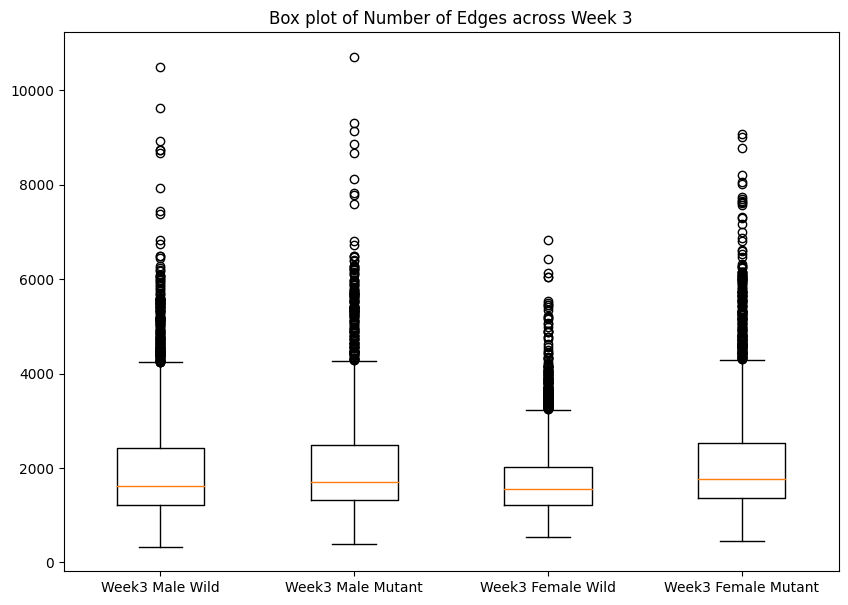

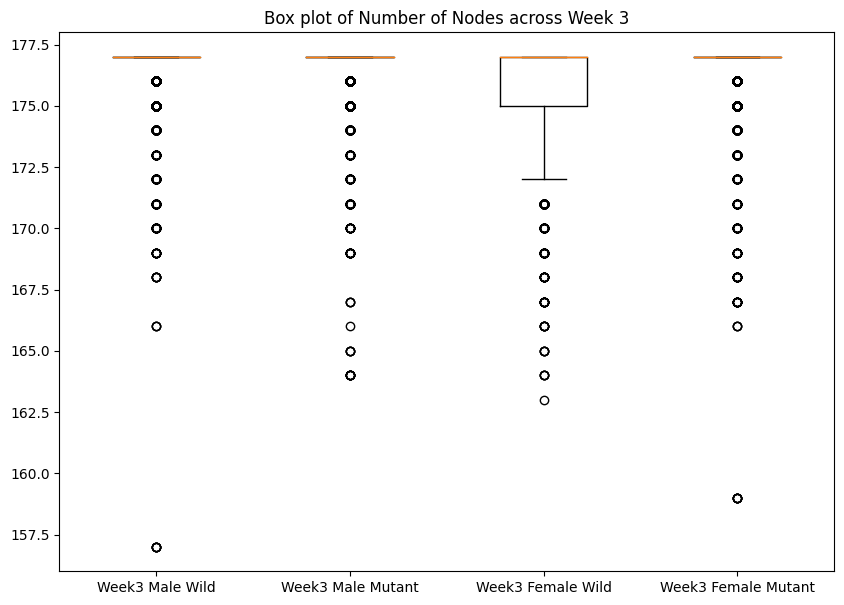

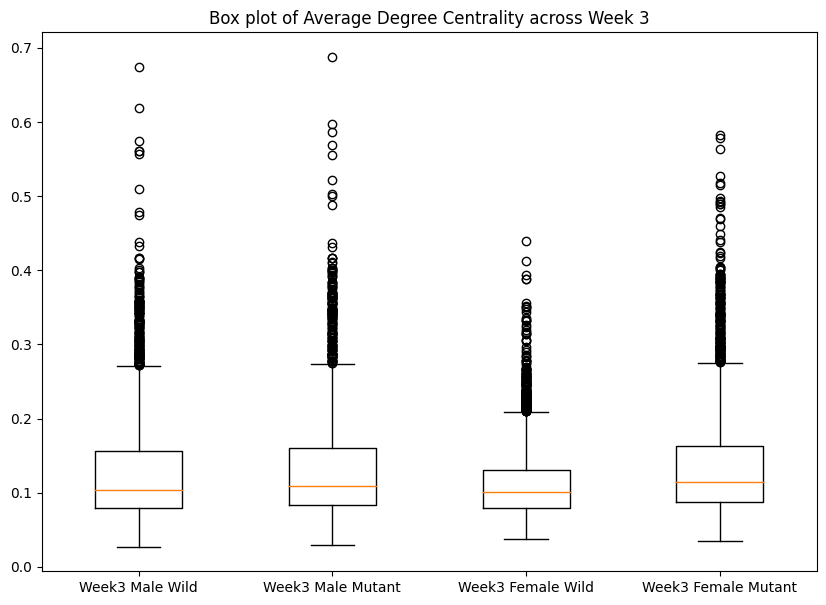

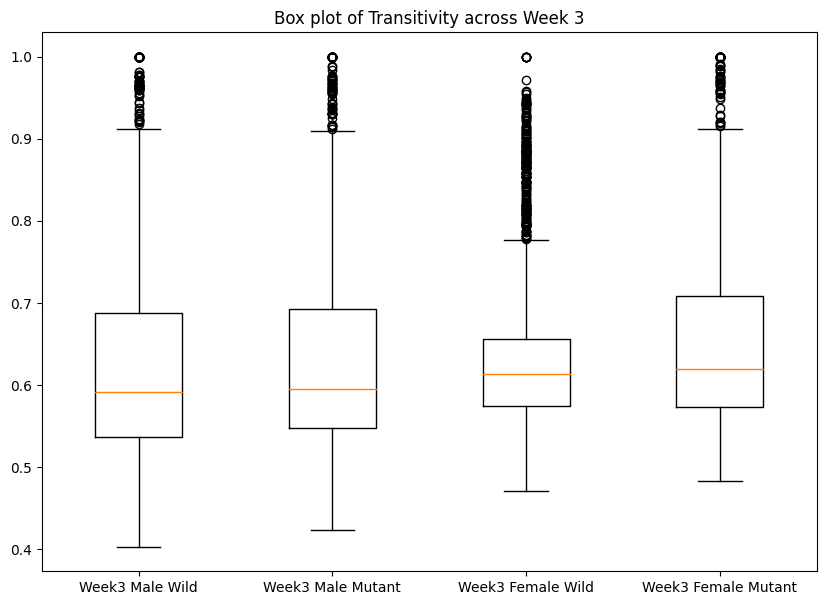

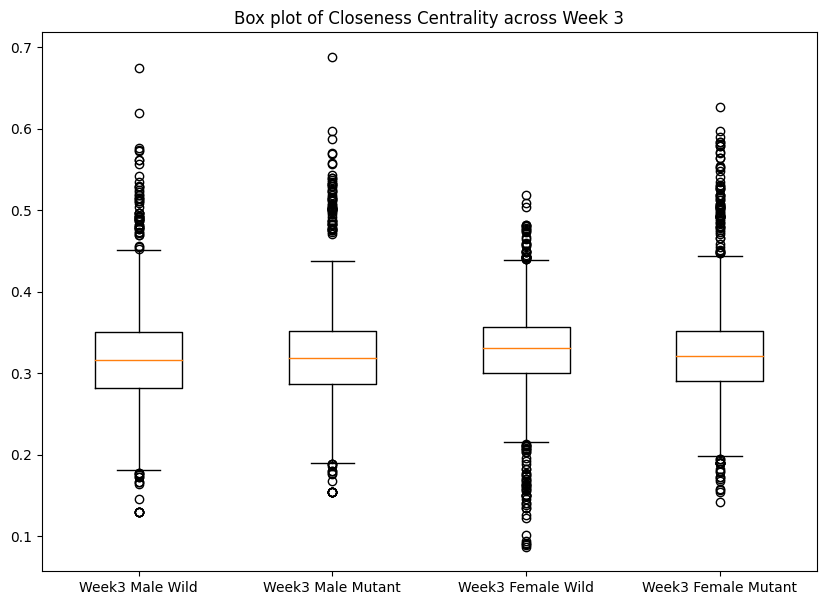

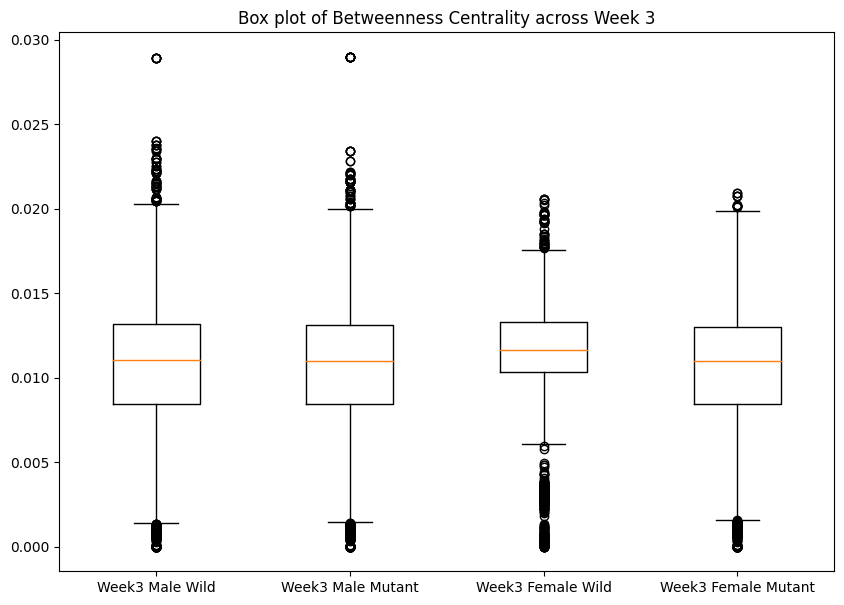

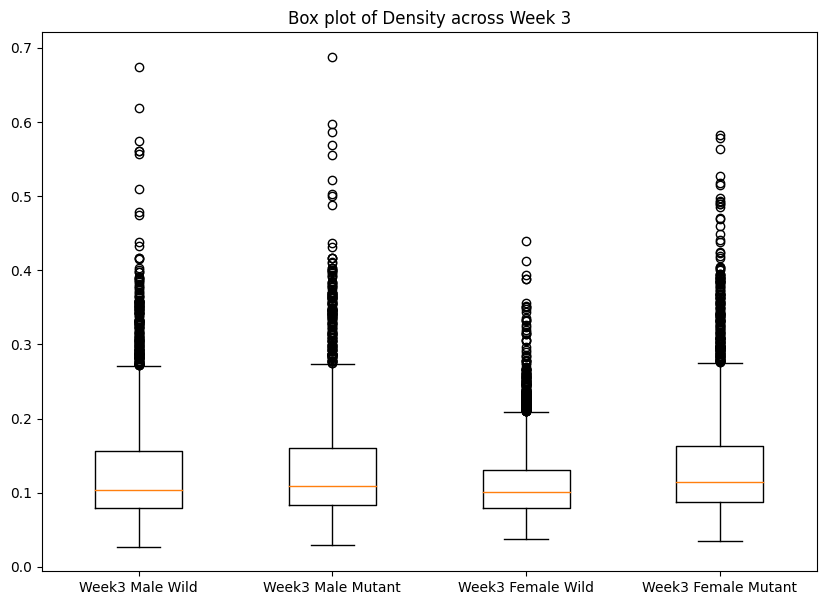

,Week3 Male Wild_mean,Week3 Male Wild_sem,Week3 Male Mutant_mean,Week3 Male Mutant_sem,Week3 Female Wild_mean,Week3 Female Wild_sem,Week3 Female Mutant_mean,Week3 Female Mutant_sem
Number of Edges,1885.665,14.443,1946.030,14.040,1731.262,10.450,2035.709,14.680
Number of Nodes,176.591,0.019,176.611,0.017,175.886,0.025,176.487,0.021
Average Degree Centrality,0.121,0.001,0.125,0.001,0.112,0.001,0.131,0.001
Transitivity,0.617,0.002,0.625,0.002,0.625,0.001,0.647,0.001
Closeness Centrality,0.316,0.001,0.319,0.001,0.329,0.001,0.321,0.001
Betweenness Centrality,0.010,0.000,0.010,0.000,0.011,0.000,0.010,0.000
Density,0.121,0.001,0.125,0.001,0.112,0.001,0.131,0.001


In [14]:
# Comparing each group's network statistics and saving the table of statistics as a csv
# Input for analyze_network_statistics must be a dictionary
week3_stats = {
    'Week3 Male Wild': week3m_w_stats,
    'Week3 Male Mutant': week3m_m_stats,
    'Week3 Female Wild': week3f_w_stats,
    'Week3 Female Mutant': week3f_m_stats
}

analyze_network_statistics(week3_stats, filename='week3_network_stats.csv', project_name='Week 3', format="PNG")

# Week 3 Visualization

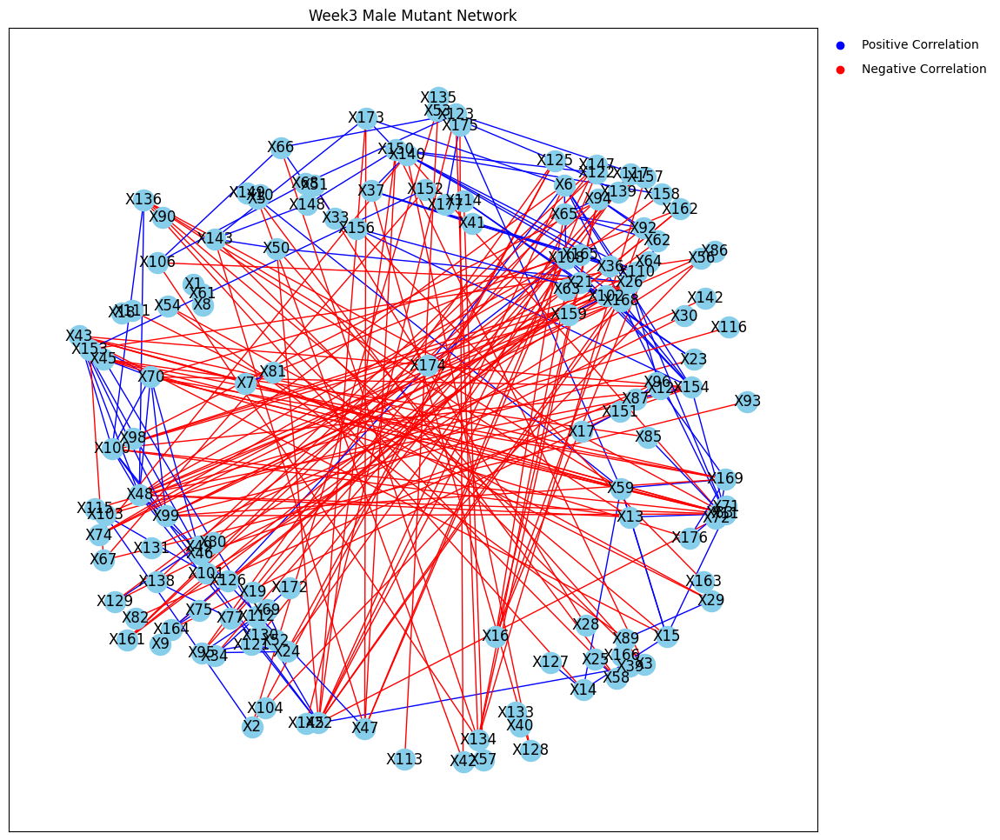

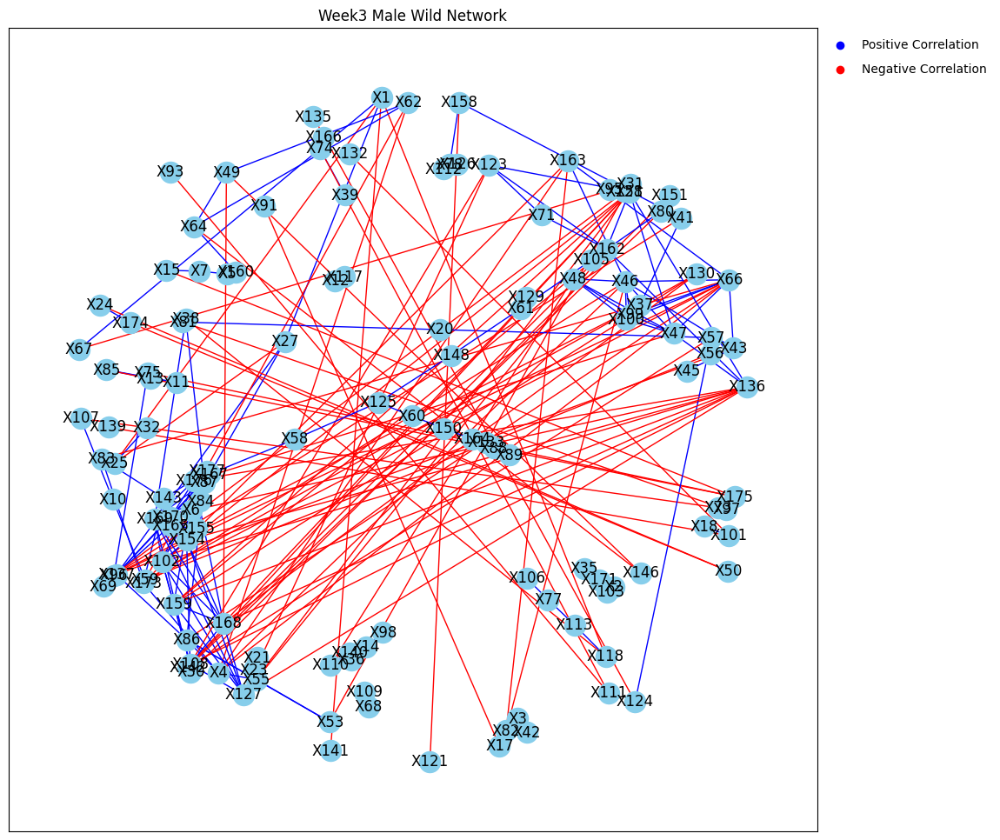

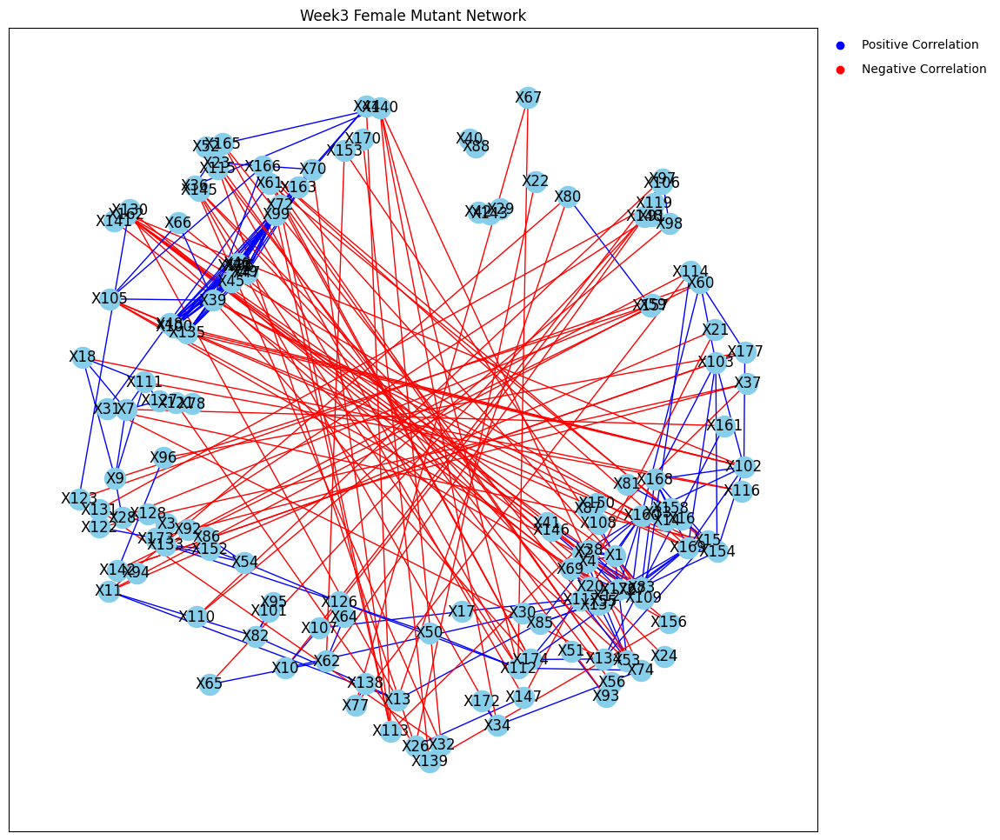

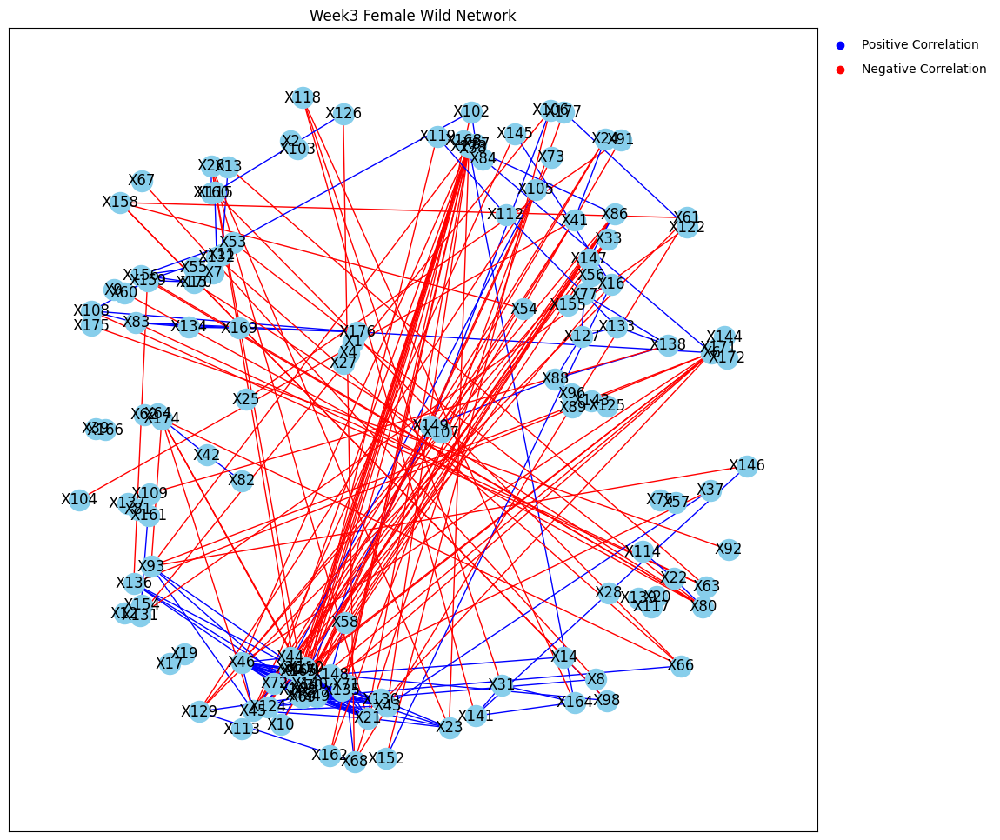

In [15]:
week3_male_mutant_network = build_network_graph(week3m_m_corr, 0.8, title = 'Week3 Male Mutant Network')
week3_male_wild_network = build_network_graph(week3m_w_corr, 0.8, title = 'Week3 Male Wild Network')
week3_female_mutant_network = build_network_graph(week3f_m_corr, 0.8, title = 'Week3 Female Mutant Network')
week3_female_wild_network = build_network_graph(week3f_w_corr, 0.8, title = 'Week3 Female Wild Network')

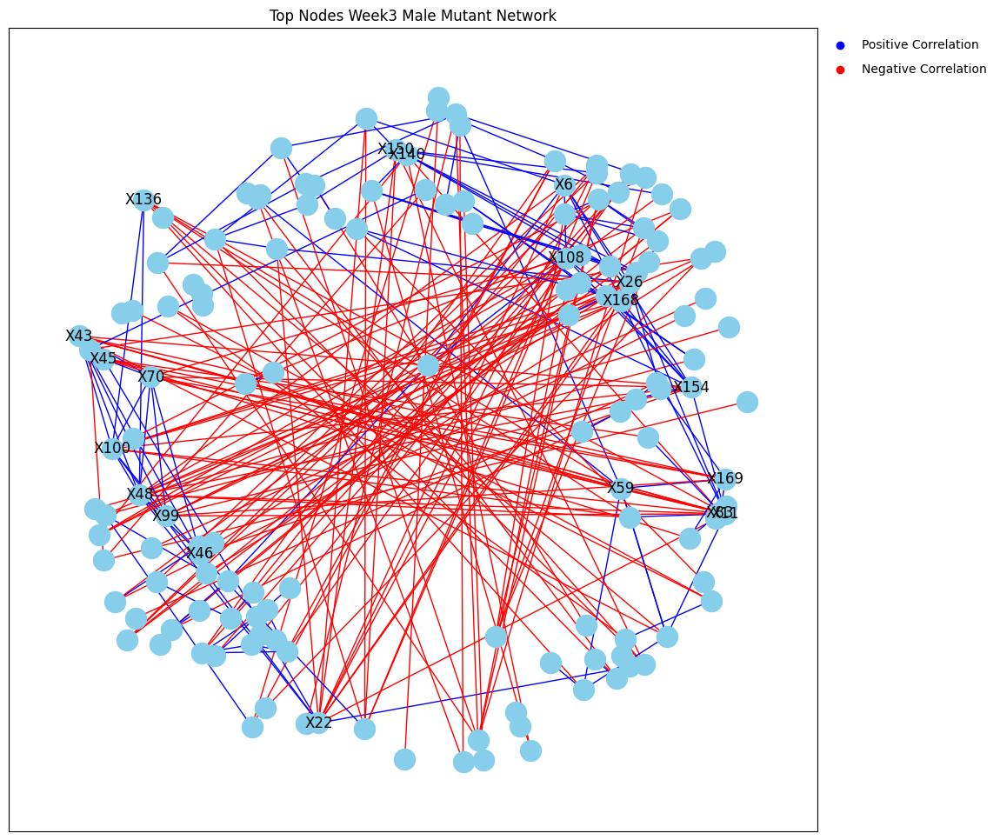

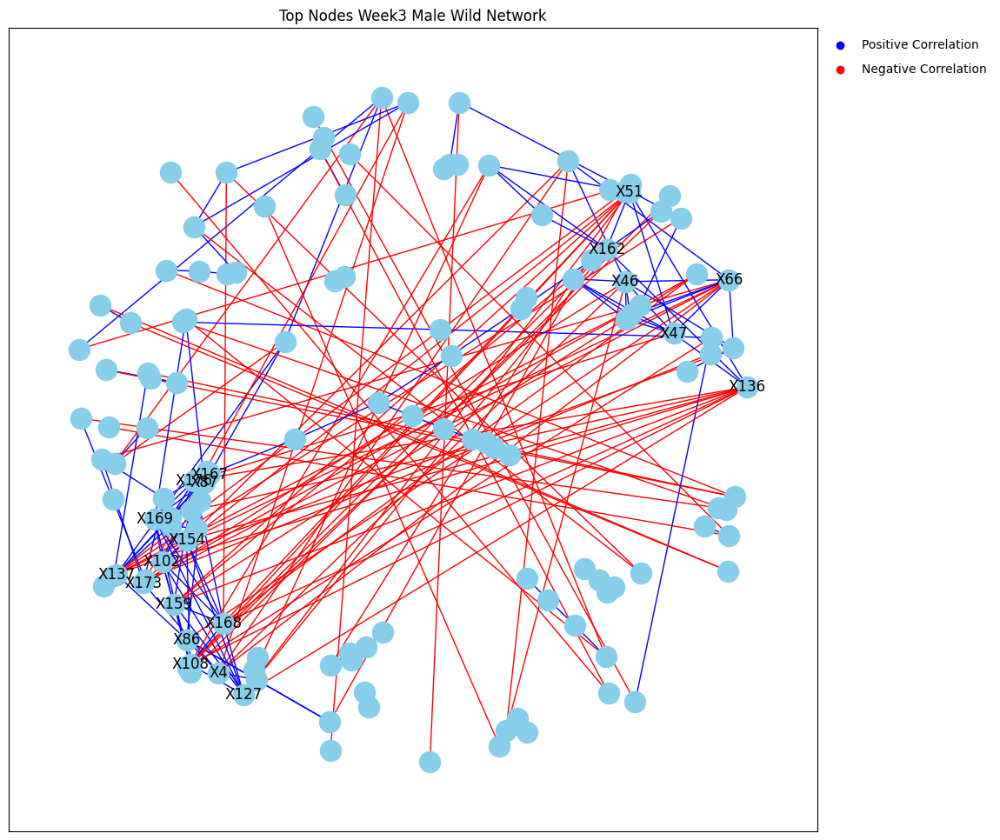

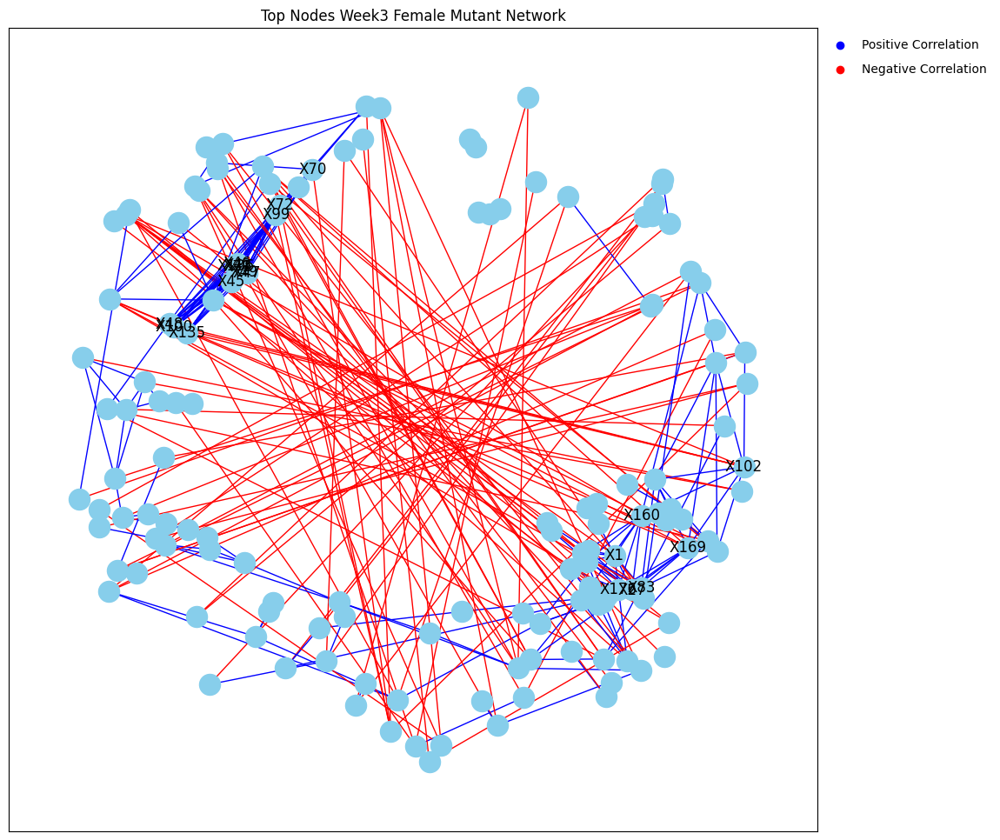

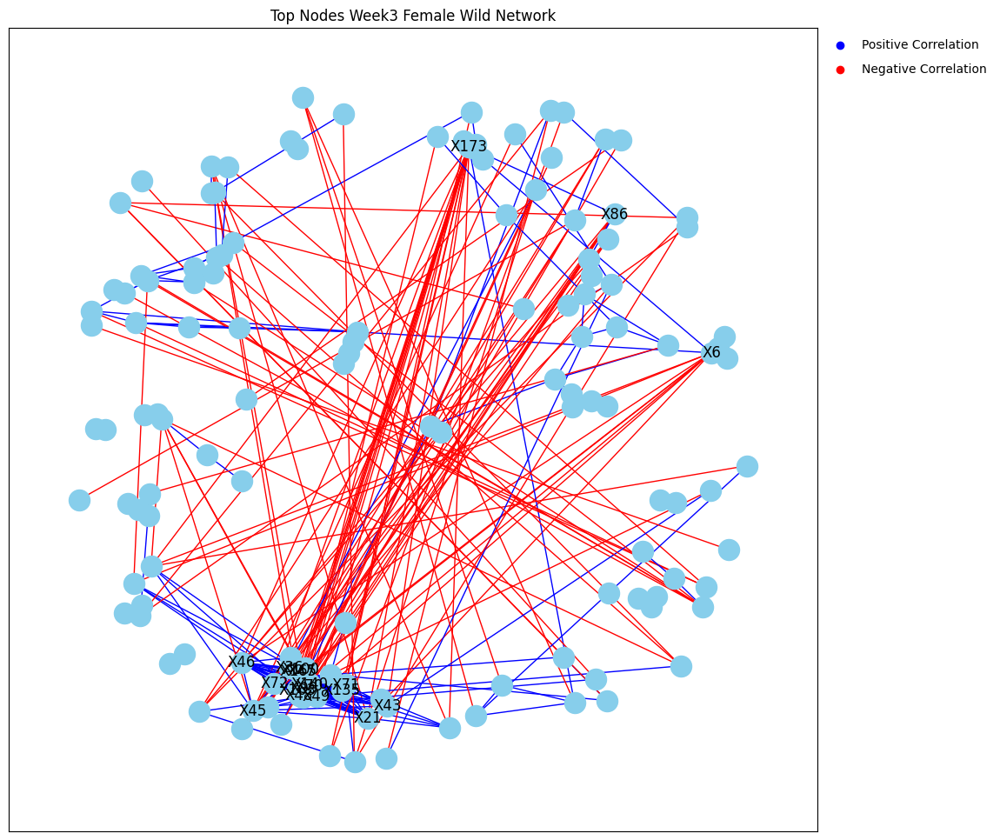

In [16]:
week3_male_mutant_network = top_nodes_network_graph(week3m_m_corr, 0.8, title = 'Top Nodes Week3 Male Mutant Network')
week3_male_wild_network = top_nodes_network_graph(week3m_w_corr, 0.8, title = 'Top Nodes Week3 Male Wild Network')
week3_female_mutant_network = top_nodes_network_graph(week3f_m_corr, 0.8, title = 'Top Nodes Week3 Female Mutant Network')
week3_female_wild_network = top_nodes_network_graph(week3f_w_corr, 0.8, title = 'Top Nodes Week3 Female Wild Network')

# Week 10 Analysis

In [17]:
week10m_m_corr = correlation_matrix(bootstrap_replicates(week10_male_mutant, 5000))

week10m_w_corr = correlation_matrix(bootstrap_replicates(week10_male_wild, 5000))

week10f_m_corr = correlation_matrix(bootstrap_replicates(week10_female_mutant, 5000))

week10f_w_corr = correlation_matrix(bootstrap_replicates(week10_female_wild, 5000))

In [18]:
week10m_w_stats = calculate_network_statistics(week10m_w_corr, 0.8)

week10m_m_stats = calculate_network_statistics(week10m_m_corr, 0.8)

week10f_w_stats = calculate_network_statistics(week10f_w_corr, 0.8)

week10f_m_stats = calculate_network_statistics(week10f_m_corr, 0.8)



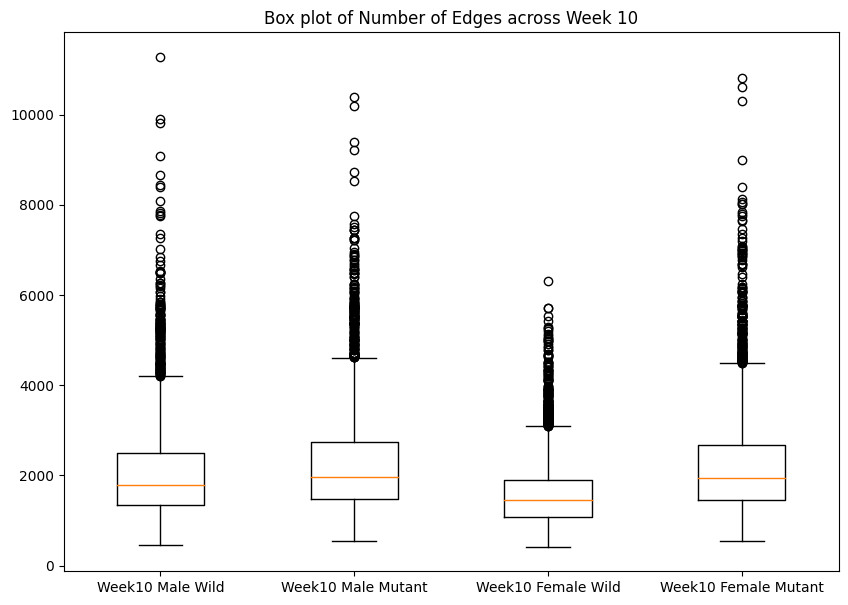

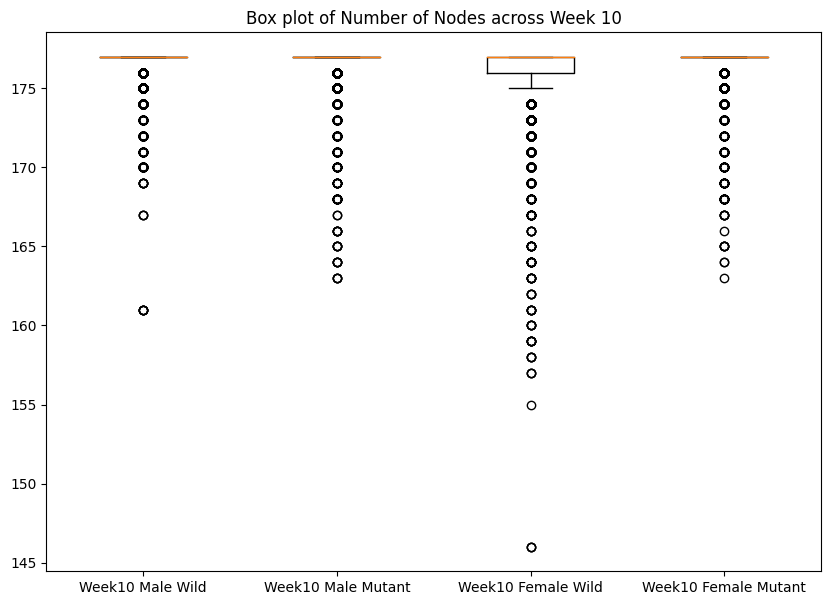

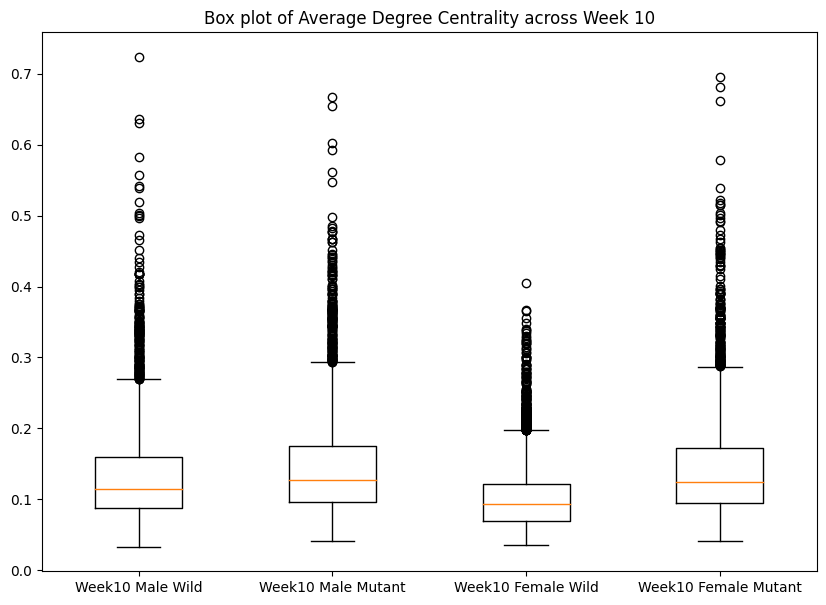

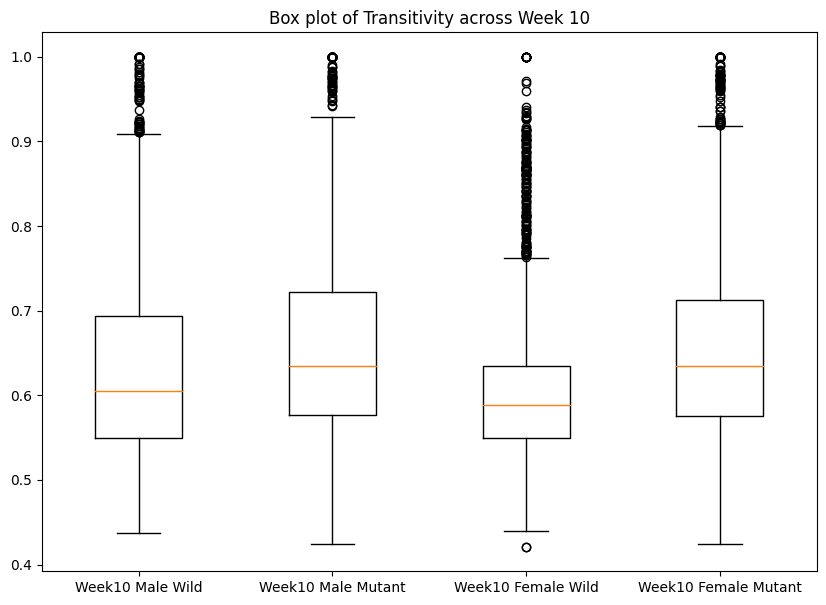

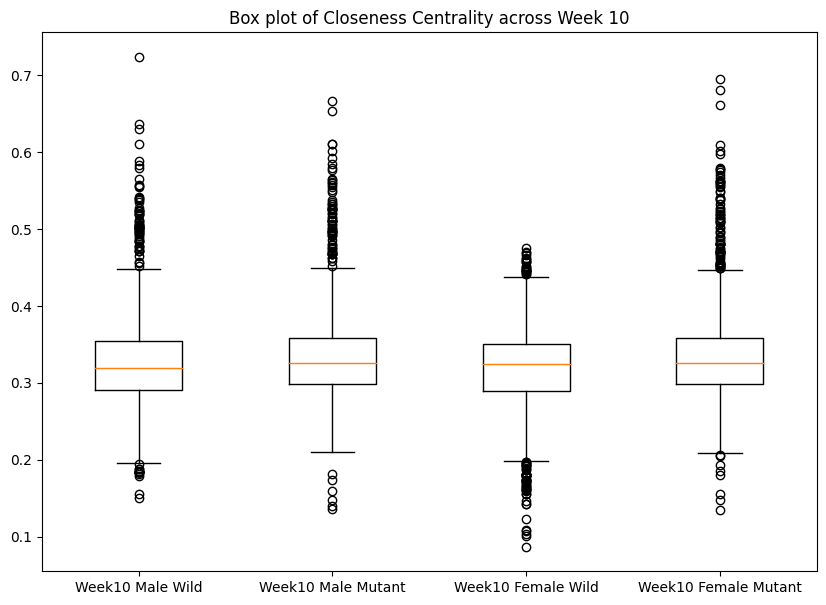

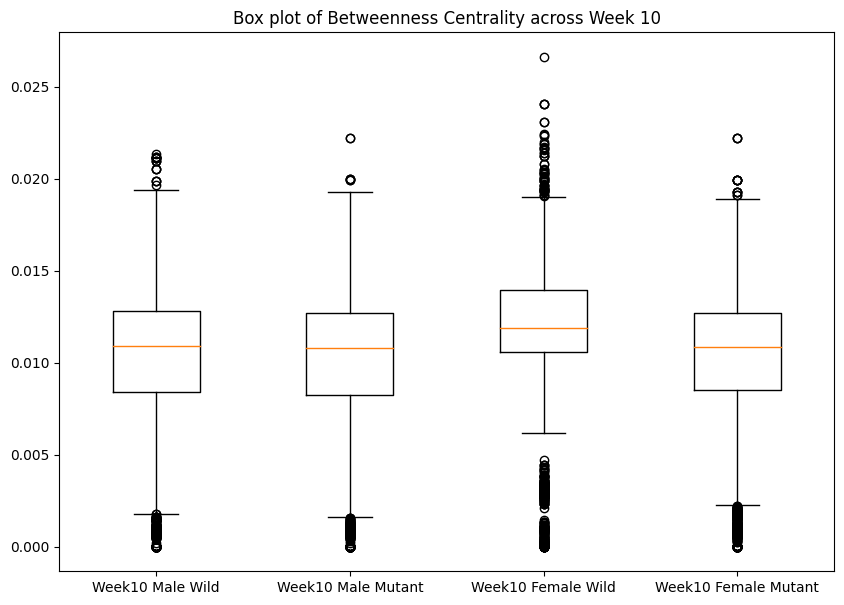

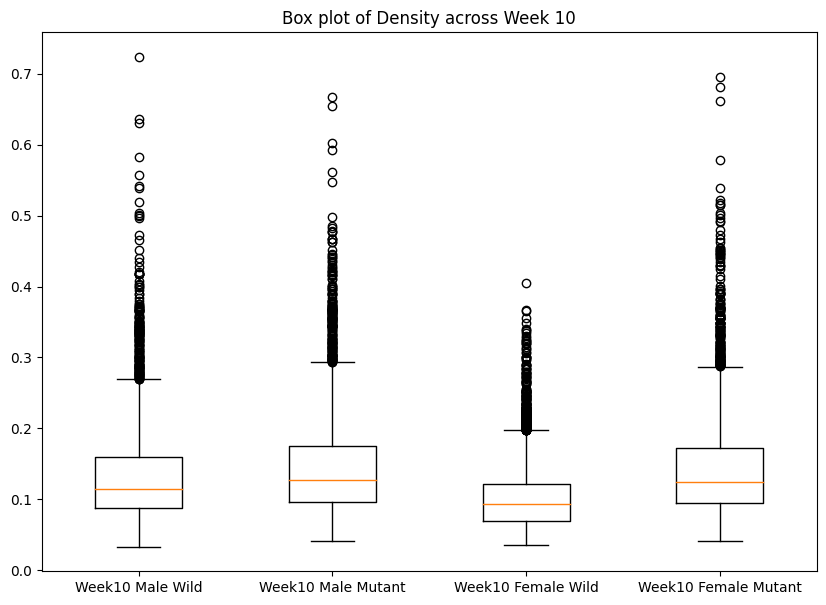

,Week10 Male Wild_mean,Week10 Male Wild_sem,Week10 Male Mutant_mean,Week10 Male Mutant_sem,Week10 Female Wild_mean,Week10 Female Wild_sem,Week10 Female Mutant_mean,Week10 Female Mutant_sem
Number of Edges,2009.013,14.247,2211.714,15.202,1614.276,10.681,2185.923,15.070
Number of Nodes,176.506,0.019,176.509,0.020,175.711,0.036,176.503,0.019
Average Degree Centrality,0.129,0.001,0.142,0.001,0.105,0.001,0.141,0.001
Transitivity,0.628,0.002,0.655,0.002,0.600,0.001,0.652,0.001
Closeness Centrality,0.322,0.001,0.328,0.001,0.321,0.001,0.329,0.001
Betweenness Centrality,0.010,0.000,0.010,0.000,0.012,0.000,0.010,0.000
Density,0.129,0.001,0.142,0.001,0.105,0.001,0.141,0.001


In [19]:
week10_stats = {
    'Week10 Male Wild': week10m_w_stats,
    'Week10 Male Mutant': week10m_m_stats,
    'Week10 Female Wild': week10f_w_stats,
    'Week10 Female Mutant': week10f_m_stats
}

analyze_network_statistics(week10_stats, filename='week10_network_stats.csv', project_name='Week 10', format="PNG" )

# Week 10 Visualization

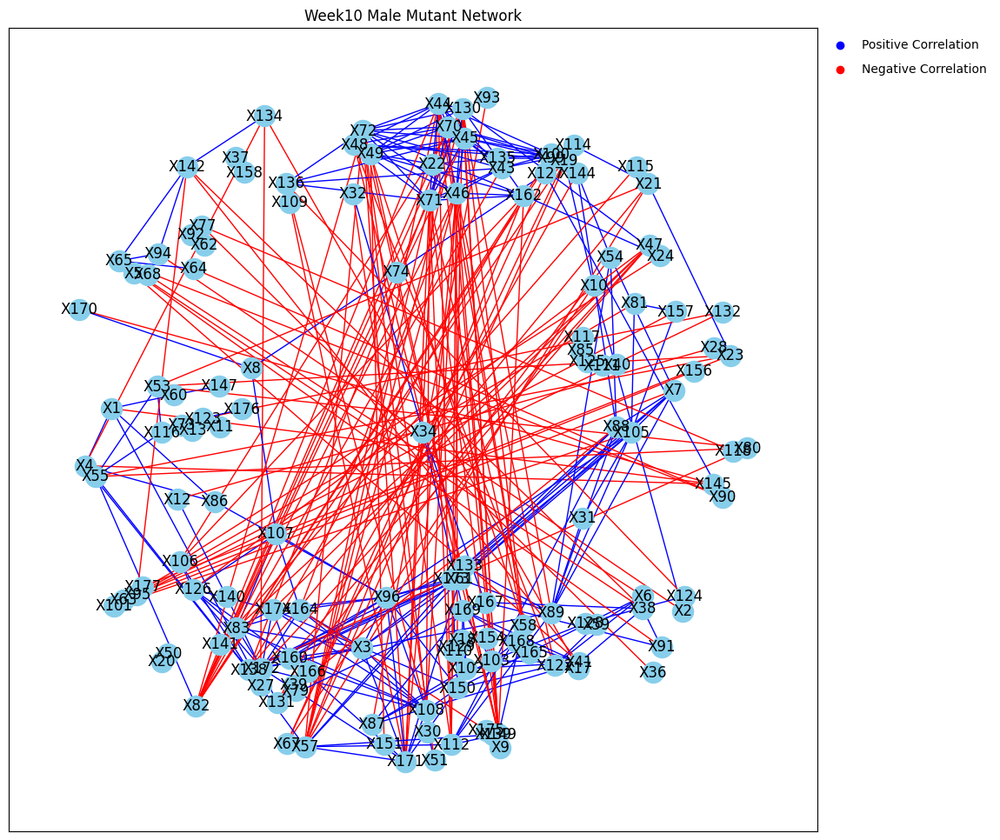

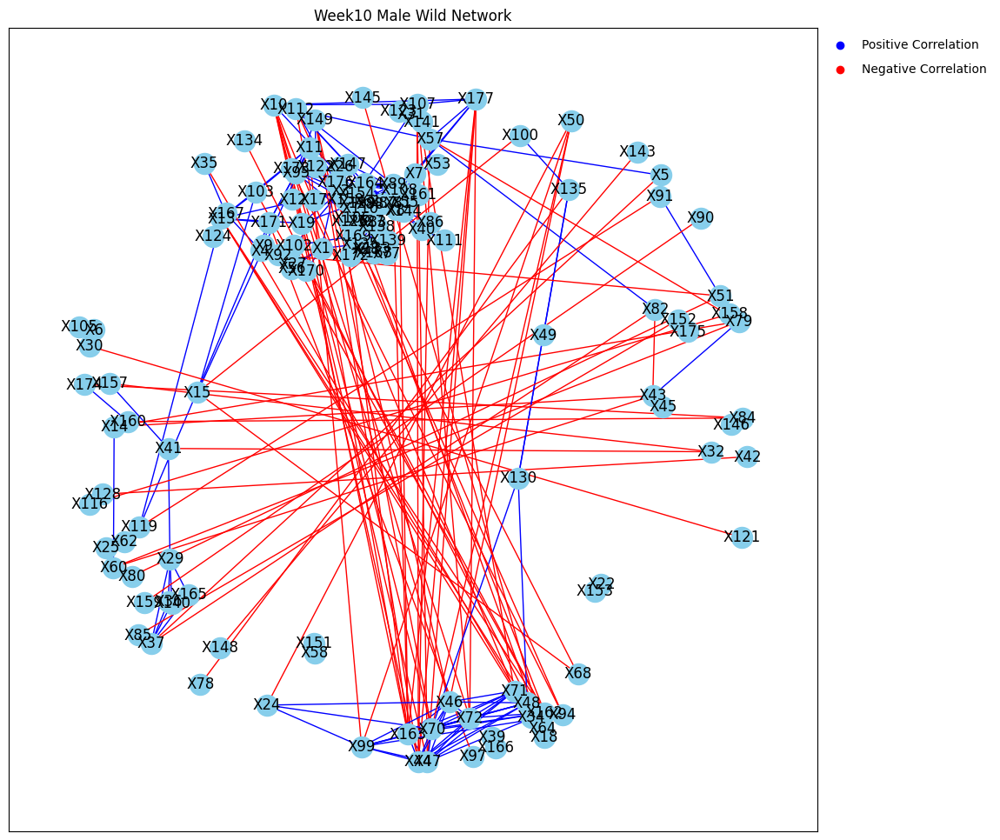

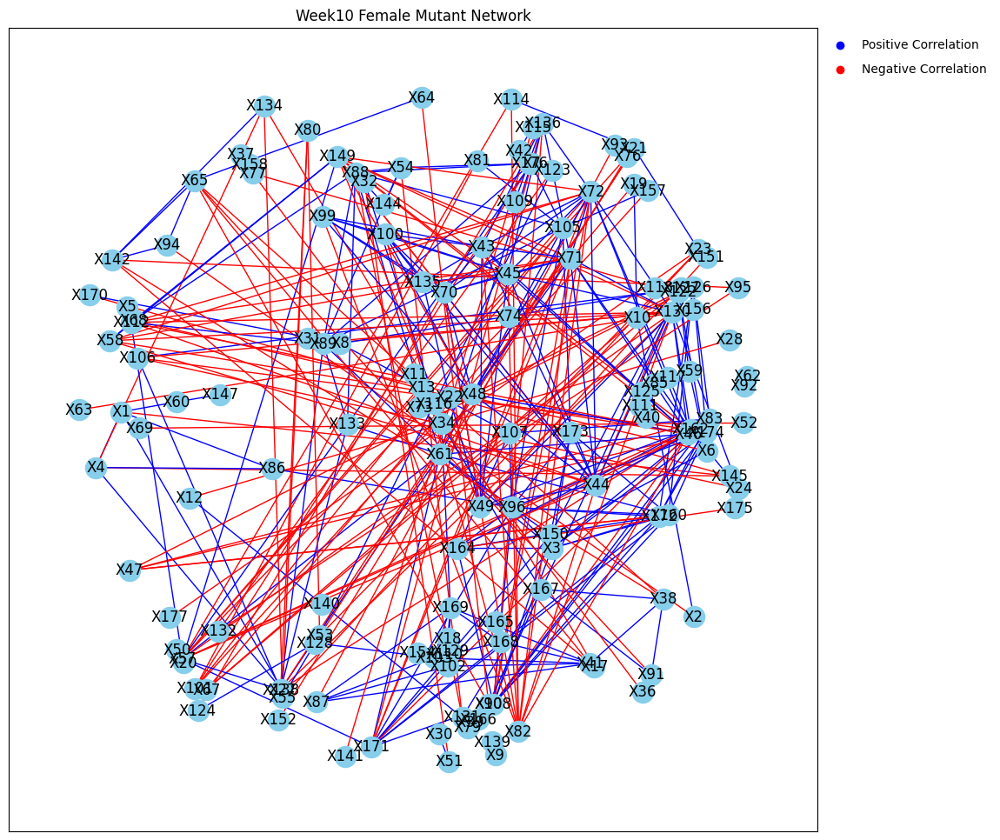

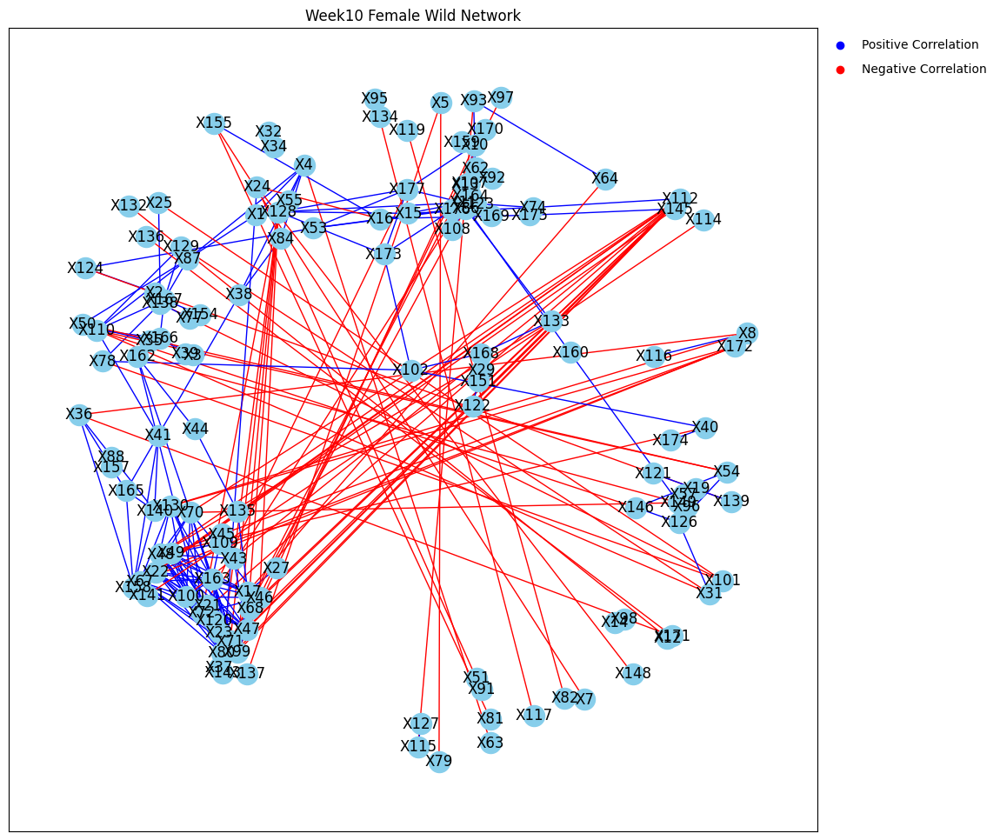

In [20]:
week10_male_mutant_network = build_network_graph(week10m_m_corr, 0.8, title = 'Week10 Male Mutant Network')
week10_male_wild_network = build_network_graph(week10m_w_corr, 0.8, title = 'Week10 Male Wild Network')
week10_female_mutant_network = build_network_graph(week10f_m_corr, 0.8, title = 'Week10 Female Mutant Network')
week10_female_wild_network = build_network_graph(week10f_w_corr, 0.8, title = 'Week10 Female Wild Network')

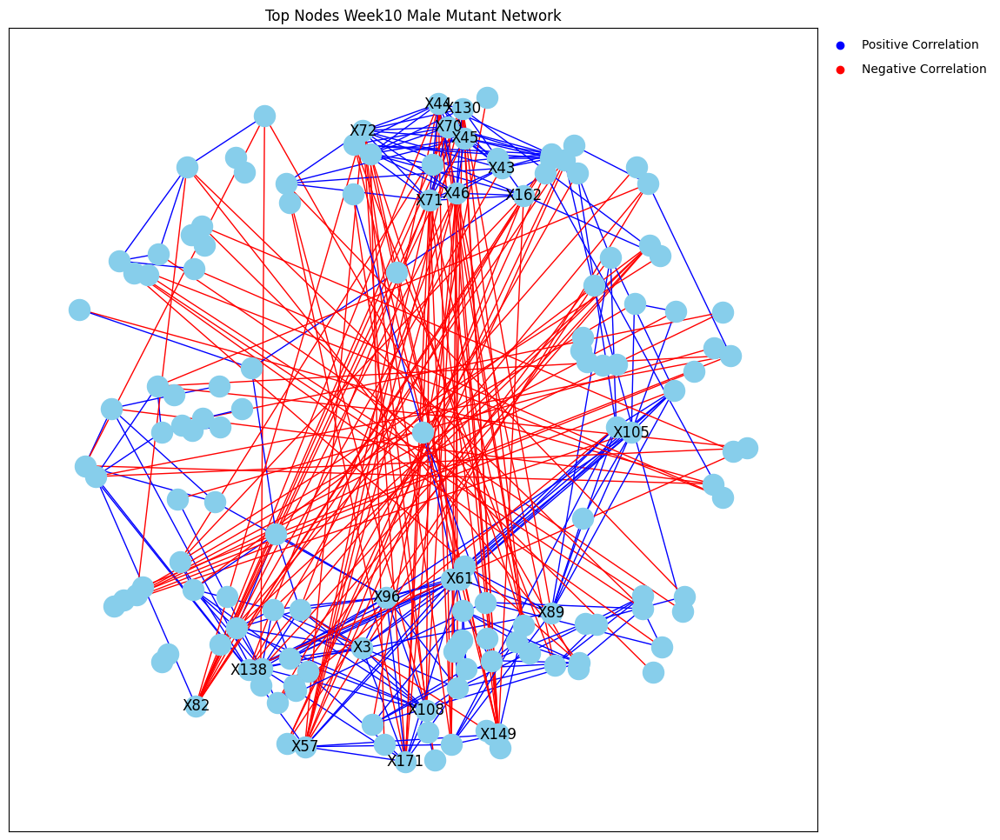

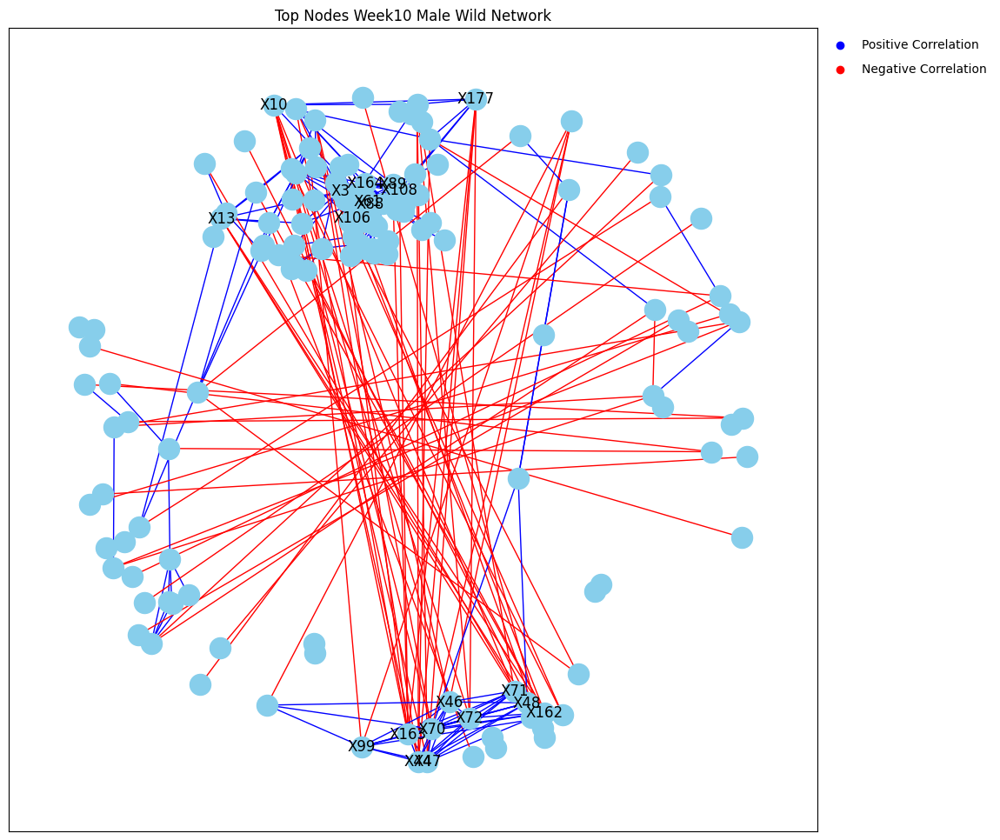

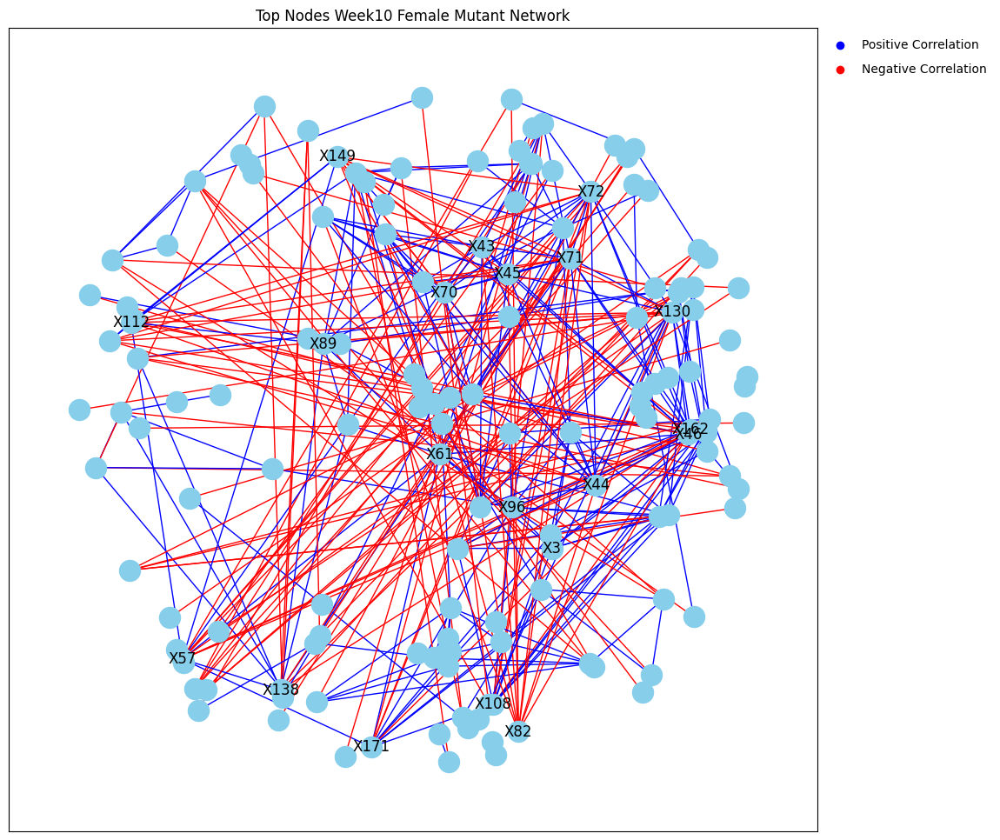

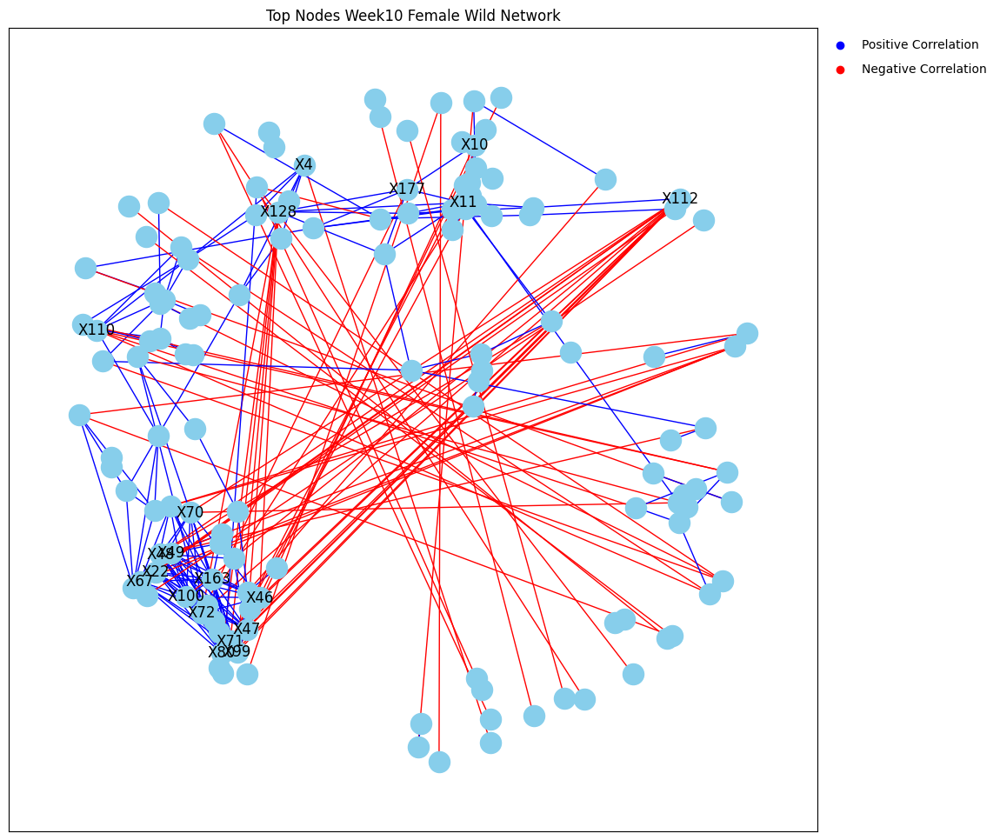

In [21]:
week10_male_mutant_network = top_nodes_network_graph(week10m_m_corr, 0.8, title = 'Top Nodes Week10 Male Mutant Network')
week10_male_wild_network = top_nodes_network_graph(week10m_w_corr, 0.8, title = 'Top Nodes Week10 Male Wild Network')
week10_female_mutant_network = top_nodes_network_graph(week10f_m_corr, 0.8, title = 'Top Nodes Week10 Female Mutant Network')
week10_female_wild_network = top_nodes_network_graph(week10f_w_corr, 0.8, title = 'Top Nodes Week10 Female Wild Network')

In [22]:
def top_nodes_network_graph1(correlations, threshold=0.8, num_nodes=20, title="Correlation Network"):
    # Check if the input is a list of DataFrames
    if isinstance(correlations, list):
        # Average out the correlation matrices
        concat_data = pd.concat(correlations)
        avg_corr_matrix = concat_data.groupby(concat_data.index).mean()
    elif isinstance(correlations, pd.DataFrame):
        # Use the DataFrame directly
        avg_corr_matrix = correlations
    else:
        raise ValueError("Input data must be a list of DataFrames or a single DataFrame")

    G = nx.Graph()

    # Adding nodes and edges with weights based on the correlations
    for i in avg_corr_matrix.columns:
        for j in avg_corr_matrix.index:
            # Filtering significant correlations
            if i != j and abs(avg_corr_matrix.at[j, i]) > threshold:
                G.add_edge(i, j, weight=avg_corr_matrix.at[j, i])

    # Drawing the network graph
    plt.figure(figsize=(12, 12))
    pos = nx.spring_layout(G, seed=42)
    edges = G.edges(data=True)
    colors = ['red' if edata['weight'] < 0 else 'blue' for _, _, edata in edges]

    # Get the top 20 nodes with the highest degree
    top_nodes = sorted(G.degree, key=lambda x: x[1], reverse=True)[:num_nodes]
    top_nodes_labels = {node: node for node, _ in top_nodes}

    nx.draw_networkx(G, pos, edge_color=colors, edge_cmap=plt.cm.coolwarm, node_color='skyblue', with_labels=False)
    nx.draw_networkx_labels(G, pos, labels=top_nodes_labels)

    # Create legend
    pos_legend = {'Positive Correlation': (0, 0), 'Negative Correlation': (0, 1)}
    for label, pos in pos_legend.items():
        plt.scatter([], [], c='blue' if label == 'Positive Correlation' else 'red', label=label)
    plt.legend(scatterpoints=1, frameon=False, labelspacing=1, bbox_to_anchor=(1, 1), loc='upper left')

    plt.title(title)
    plt.savefig(title + ".PNG", format="PNG", bbox_inches='tight')
    plt.show()

    # Return the graph and the list of top 20 nodes
    return G, [node for node, _ in top_nodes]

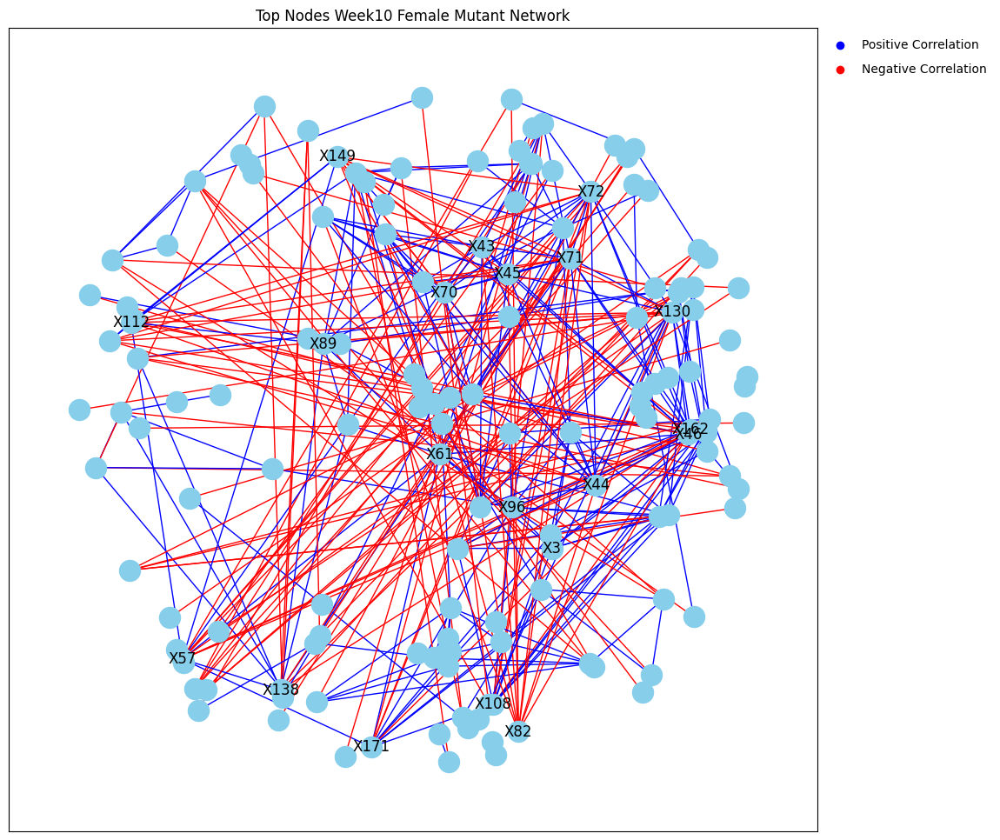

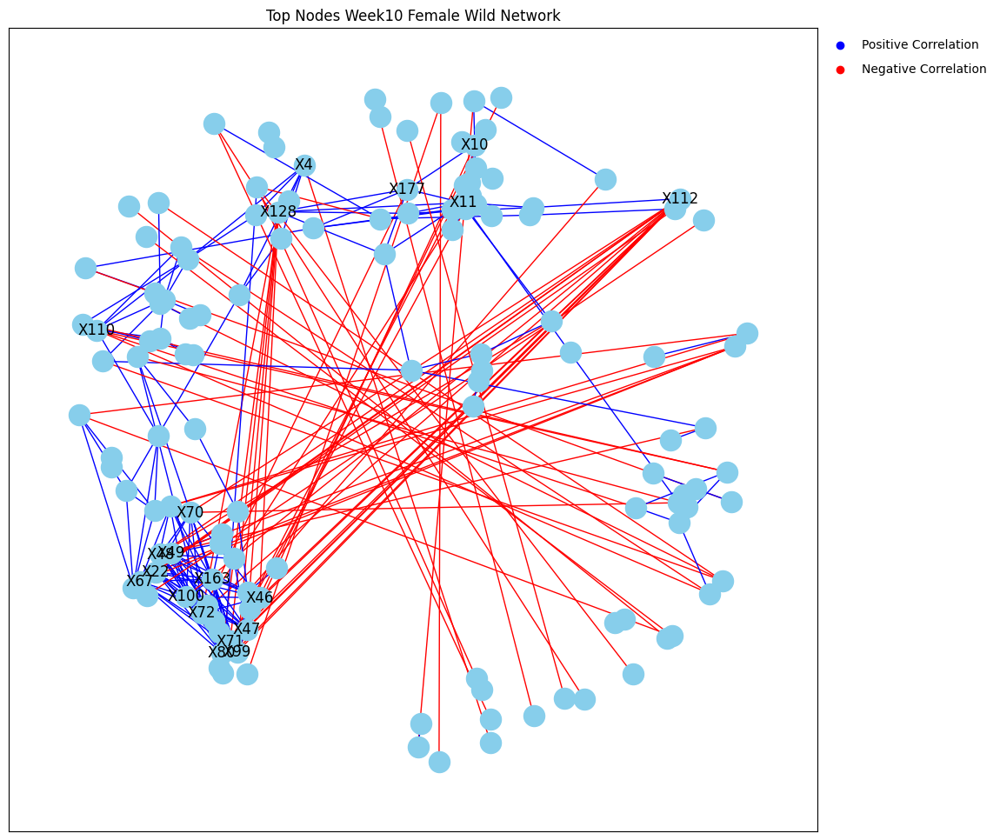

In [23]:
week10_female_mutant_network = top_nodes_network_graph1(week10f_m_corr, 0.8, title = 'Top Nodes Week10 Female Mutant Network')
week10_female_wild_network = top_nodes_network_graph1(week10f_w_corr, 0.8, title = 'Top Nodes Week10 Female Wild Network')

In [24]:
week10fm_nodes = top_nodes(week10f_m_corr, threshold=0.8, num_nodes=5)
week10fw_nodes = top_nodes(week10f_w_corr, threshold=0.8, num_nodes=5)
week10mm_nodes = top_nodes(week10m_m_corr, threshold=0.8, num_nodes=5)
week10mw_nodes = top_nodes(week10m_w_corr, threshold=0.8, num_nodes=5)

In [25]:
print(" Week 10 Female Mutant: ", week10fm_nodes,"\n",
      "Week 10 Female Wild:","\t", week10fw_nodes,"\n")

 Week 10 Female Mutant:  ['X71', 'X72', 'X130', 'X44', 'X46'] 
 Week 10 Female Wild: 	 ['X99', 'X80', 'X71', 'X22', 'X47'] 



In [26]:
Week10TopNodes = pd.DataFrame({
    'Week 10 Female Mutant': week10fm_nodes,
    'Week 10 Female Wild': week10fw_nodes
})

In [27]:
species_dictionary = pd.read_csv('Species Dictionary.csv')

In [28]:
species_dictionary

,X,Species
0,X1,14-2_sp
1,X2,14-2_sp000403315
2,X3,14-2_sp004793545
3,X4,14-2_sp910576385
4,X5,14-2_sp910577785
...,...,...
172,X173,Ventrimonas_sp
173,X174,Ventrimonas_sp910577765
174,X175,Zhenpiania_sp
175,X176,[Clostridium]_clostridioforme


In [29]:
import csv

# Read the CSV data and create a dictionary
species_dict = {}
with open('Species Dictionary.csv', 'r') as file:
    csv_reader = csv.reader(file)
    for row in csv_reader:
        if len(row) == 2:
            x_value, species_name = row
            species_dict[x_value] = species_name

In [30]:
# Example list of X values
x_values = week10fm_nodes

# Map the X values to their corresponding species names
mapped_species = [species_dict.get(x, 'Unknown') for x in x_values]

# Print the mapped species names
print('Week 10 Female Mutant')
for x, species in zip(x_values, mapped_species):
    print(f"{x}: {species}")


Week 10 Female Mutant
X71: Duncaniella_muris
X72: Duncaniella_sp
X130: Muribaculum_intestinale
X44: CAG-485_sp002361215
X46: CAG-873_sp


In [31]:
y_values = week10fw_nodes
mapped_species = [species_dict.get(y, 'Unknown') for y in y_values]

print('Week 10 Female Wild')
for y, species in zip(y_values, mapped_species):
    print(f"{y}: {species}")

Week 10 Female Wild
X99: JAFLTL01_sp
X80: Enterorhabdus_sp009911695
X71: Duncaniella_muris
X22: Adlercreutzia_sp
X47: CAG-873_sp002490635


# Statistical Testing

In [32]:
# Testing between week 3  vs week 10 of the Male Wild type 
male_wild_binom = net_stat_binomial_test(week3m_w_stats, week10m_w_stats, title = 'Male Wild type p-values.csv')
male_wild_binom

{'Number of Edges': BinomTestResult(k=2241, n=5000, alternative='two-sided', statistic=0.4482, pvalue=2.518790451582366e-13),
 'Number of Nodes': BinomTestResult(k=1012, n=5000, alternative='two-sided', statistic=0.2024, pvalue=0.0),
 'Average Degree Centrality': BinomTestResult(k=2219, n=5000, alternative='two-sided', statistic=0.4438, pvalue=1.9900107106847735e-15),
 'Transitivity': BinomTestResult(k=2333, n=5000, alternative='two-sided', statistic=0.4666, pvalue=2.46509010906905e-06),
 'Closeness Centrality': BinomTestResult(k=2303, n=5000, alternative='two-sided', statistic=0.4606, pvalue=2.687960423376497e-08),
 'Betweenness Centrality': BinomTestResult(k=2618, n=5000, alternative='two-sided', statistic=0.5236, pvalue=0.0008874933648516884),
 'Density': BinomTestResult(k=2219, n=5000, alternative='two-sided', statistic=0.4438, pvalue=1.9900107106847735e-15)}

In [33]:
# Testing between week 3  vs week 10 of the Male Mutant type
male_mutant_binom = net_stat_binomial_test(week3m_m_stats, week10m_m_stats, title= 'Male Mutant type p-values.csv')
male_mutant_binom

{'Number of Edges': BinomTestResult(k=2095, n=5000, alternative='two-sided', statistic=0.419, pvalue=1.955044697242838e-30),
 'Number of Nodes': BinomTestResult(k=941, n=5000, alternative='two-sided', statistic=0.1882, pvalue=0.0),
 'Average Degree Centrality': BinomTestResult(k=2076, n=5000, alternative='two-sided', statistic=0.4152, pvalue=3.2595624008091195e-33),
 'Transitivity': BinomTestResult(k=2001, n=5000, alternative='two-sided', statistic=0.4002, pvalue=1.9525928520757966e-45),
 'Closeness Centrality': BinomTestResult(k=2228, n=5000, alternative='two-sided', statistic=0.4456, pvalue=1.5106037567243042e-14),
 'Betweenness Centrality': BinomTestResult(k=2641, n=5000, alternative='two-sided', statistic=0.5282, pvalue=7.040263629161705e-05),
 'Density': BinomTestResult(k=2076, n=5000, alternative='two-sided', statistic=0.4152, pvalue=3.2595624008091195e-33)}

In [34]:
#Testing between week 3  vs week 10 of the Female Wild type
female_wild_binom = net_stat_binomial_test(week3f_w_stats, week10f_w_stats, title= 'Female Wild type p-values.csv')
female_wild_binom

{'Number of Edges': BinomTestResult(k=2840, n=5000, alternative='two-sided', statistic=0.568, pvalue=6.764426818281771e-22),
 'Number of Nodes': BinomTestResult(k=1555, n=5000, alternative='two-sided', statistic=0.311, pvalue=3.887645956393242e-161),
 'Average Degree Centrality': BinomTestResult(k=2835, n=5000, alternative='two-sided', statistic=0.567, pvalue=2.6641230775838287e-21),
 'Transitivity': BinomTestResult(k=3062, n=5000, alternative='two-sided', statistic=0.6124, pvalue=2.8786808255844706e-57),
 'Closeness Centrality': BinomTestResult(k=2797, n=5000, alternative='two-sided', statistic=0.5594, pvalue=4.618428014185817e-17),
 'Betweenness Centrality': BinomTestResult(k=2234, n=5000, alternative='two-sided', statistic=0.4468, pvalue=5.6289998802094236e-14),
 'Density': BinomTestResult(k=2835, n=5000, alternative='two-sided', statistic=0.567, pvalue=2.6641230775838287e-21)}

In [35]:
#Testing between week 3  vs week 10 of the Female Mutant type
female_mutant_binom = net_stat_binomial_test(week3f_m_stats, week10f_m_stats, title= 'Female Mutant type p-values.csv')
female_mutant_binom

{'Number of Edges': BinomTestResult(k=2245, n=5000, alternative='two-sided', statistic=0.449, pvalue=5.827156368948627e-13),
 'Number of Nodes': BinomTestResult(k=953, n=5000, alternative='two-sided', statistic=0.1906, pvalue=0.0),
 'Average Degree Centrality': BinomTestResult(k=2222, n=5000, alternative='two-sided', statistic=0.4444, pvalue=3.939182244884688e-15),
 'Transitivity': BinomTestResult(k=2390, n=5000, alternative='two-sided', statistic=0.478, pvalue=0.0019511330726166352),
 'Closeness Centrality': BinomTestResult(k=2284, n=5000, alternative='two-sided', statistic=0.4568, pvalue=1.0677216297687802e-09),
 'Betweenness Centrality': BinomTestResult(k=2573, n=5000, alternative='two-sided', statistic=0.5146, pvalue=0.040294297259548674),
 'Density': BinomTestResult(k=2222, n=5000, alternative='two-sided', statistic=0.4444, pvalue=3.939182244884688e-15)}

In [36]:
#Testing between Female Mutant and Wild type at Week 10
female_binom_week10 = net_stat_binomial_test(week10f_m_stats, week10f_w_stats, title= 'Female binom Week 10 type p-values.csv')
female_binom_week10

{'Number of Edges': BinomTestResult(k=3412, n=5000, alternative='two-sided', statistic=0.6824, pvalue=6.007697299399607e-150),
 'Number of Nodes': BinomTestResult(k=1837, n=5000, alternative='two-sided', statistic=0.3674, pvalue=2.90891527364137e-79),
 'Average Degree Centrality': BinomTestResult(k=3395, n=5000, alternative='two-sided', statistic=0.679, pvalue=2.3569812724101893e-144),
 'Transitivity': BinomTestResult(k=3287, n=5000, alternative='two-sided', statistic=0.6574, pvalue=1.771627905432188e-111),
 'Closeness Centrality': BinomTestResult(k=2690, n=5000, alternative='two-sided', statistic=0.538, pvalue=8.214547210448348e-08),
 'Betweenness Centrality': BinomTestResult(k=1798, n=5000, alternative='two-sided', statistic=0.3596, pvalue=9.07103952352856e-89),
 'Density': BinomTestResult(k=3395, n=5000, alternative='two-sided', statistic=0.679, pvalue=2.3569812724101893e-144)}